In [ ]:
import nltk
nltk.download('all',halt_on_error=False)

[nltk_data] Downloading collection 'all'
[nltk_data]    | 
[nltk_data]    | Downloading package abc to /root/nltk_data...
[nltk_data]    |   Package abc is already up-to-date!
[nltk_data]    | Downloading package alpino to /root/nltk_data...
[nltk_data]    |   Package alpino is already up-to-date!
[nltk_data]    | Downloading package averaged_perceptron_tagger to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Package averaged_perceptron_tagger is already up-
[nltk_data]    |       to-date!
[nltk_data]    | Downloading package averaged_perceptron_tagger_ru to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Package averaged_perceptron_tagger_ru is already
[nltk_data]    |       up-to-date!
[nltk_data]    | Downloading package basque_grammars to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Package basque_grammars is already up-to-date!
[nltk_data]    | Downloading package bcp47 to /root/nltk_data...
[nltk_data]    |   Package bcp47 is already up-to-dat

True

In [ ]:
!pip install --upgrade keras

  Using cached keras-3.0.2-py3-none-any.whl (1.0 MB)
  Attempting uninstall: keras
    Found existing installation: keras 2.15.0
    Uninstalling keras-2.15.0:
      Successfully uninstalled keras-2.15.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.15.0 requires keras<2.16,>=2.15.0, but you have keras 3.0.2 which is incompatible.


In [ ]:
!pip install tensorflow

  Using cached keras-2.15.0-py3-none-any.whl (1.7 MB)
  Attempting uninstall: keras
    Found existing installation: keras 3.0.2
    Uninstalling keras-3.0.2:
      Successfully uninstalled keras-3.0.2


In [ ]:
# Ignore  the warnings
import warnings
warnings.filterwarnings('always')
warnings.filterwarnings('ignore')

# data visualisation and manipulation
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import style
import seaborn as sns
#configure
style.use('fivethirtyeight')
sns.set(style='whitegrid',color_codes=True)

# nltk
import nltk

# preprocessing
from nltk.corpus import stopwords
from nltk import word_tokenize, sent_tokenize
from nltk.stem import PorterStemmer, LancasterStemmer
from nltk.stem.snowball import SnowballStemmer
from nltk.stem import WordNetLemmatizer
from nltk import pos_tag
from nltk import ne_chunk

# vectorizers for creating the document-term-matrix (DTM)
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer

# BeautifulSoup library
from bs4 import BeautifulSoup

import re

# model_selection
from sklearn.model_selection import train_test_split, cross_validate
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV

# evaluation
from sklearn.metrics import accuracy_score, roc_auc_score
from sklearn.metrics import classification_report
from mlxtend.plotting import plot_confusion_matrix

# preprocessing scikit
from sklearn.preprocessing import MinMaxScaler, StandardScaler, LabelEncoder
from sklearn.impute import SimpleImputer

# classification
from sklearn.linear_model import LogisticRegression
from sklearn.svm import LinearSVC, SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB, MultinomialNB
from keras.preprocessing.sequence import pad_sequences


# stop-words
stop_words = set(nltk.corpus.stopwords.words('english'))

# keras
import keras
from keras.preprocessing.text import one_hot, Tokenizer

from keras.models import Sequential
from keras.layers import Dense, Flatten, Embedding, Input
from keras.models import Model
from keras.preprocessing.text import text_to_word_sequence

# gensim w2v
# word2vec
from gensim.models import Word2Vec

In [ ]:
rev_frame=pd.read_csv(r'/content/mydb1.project.csv')

In [ ]:
df=rev_frame.copy()

In [ ]:
df.head()

,_id,link,headline,category,short_description,authors,date
0,654b082afdb6c207af1ec86f,https://www.huffpost.com/entry/covid-boosters-...,Over 4 Million Americans Roll Up Sleeves For O...,U.S. NEWS,Health experts said it is too early to predict...,"Carla K. Johnson, AP",2022-09-23
1,654b082afdb6c207af1ec870,https://www.huffpost.com/entry/american-airlin...,"American Airlines Flyer Charged, Banned For Li...",U.S. NEWS,He was subdued by passengers and crew when he ...,Mary Papenfuss,2022-09-23
2,654b082afdb6c207af1ec871,https://www.huffpost.com/entry/funniest-tweets...,23 Of The Funniest Tweets About Cats And Dogs ...,COMEDY,"""Until you have a dog you don't understand wha...",Elyse Wanshel,2022-09-23
3,654b082afdb6c207af1ec872,https://www.huffpost.com/entry/funniest-parent...,The Funniest Tweets From Parents This Week (Se...,PARENTING,"""Accidentally put grown-up toothpaste on my to...",Caroline Bologna,2022-09-23
4,654b082afdb6c207af1ec873,https://www.huffpost.com/entry/amy-cooper-lose...,Woman Who Called Cops On Black Bird-Watcher Lo...,U.S. NEWS,Amy Cooper accused investment firm Franklin Te...,Nina Golgowski,2022-09-22


In [ ]:
print(df.shape)

In [ ]:
df=df[['link','headline']]

In [ ]:
df['article']=df['link']
df['brief']=df['headline']
df.drop(['link','headline'],axis=1,inplace=True)

In [ ]:
print(df.shape)
df.head()

(76403, 2)


,article,brief
0,https://www.huffpost.com/entry/covid-boosters-...,Over 4 Million Americans Roll Up Sleeves For O...
1,https://www.huffpost.com/entry/american-airlin...,"American Airlines Flyer Charged, Banned For Li..."
2,https://www.huffpost.com/entry/funniest-tweets...,23 Of The Funniest Tweets About Cats And Dogs ...
3,https://www.huffpost.com/entry/funniest-parent...,The Funniest Tweets From Parents This Week (Se...
4,https://www.huffpost.com/entry/amy-cooper-lose...,Woman Who Called Cops On Black Bird-Watcher Lo...


In [ ]:
# check for null values
print(df['article'].isnull().sum())
df['article'].isnull().sum()  # no null values.

0


0

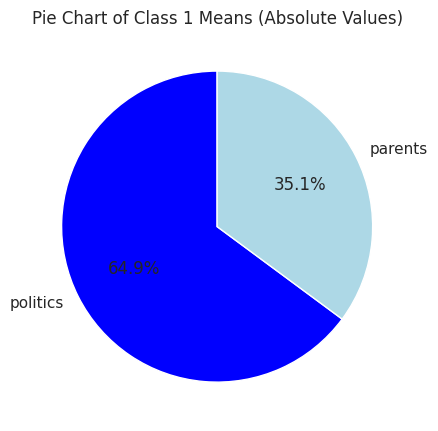

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Generate sample data with two classes
np.random.seed(42)
class_1 = np.random.randn(35602, 2)
class_2 = np.random.randn(3955, 2)

# Calculate the means of each feature for both classes
class_1_mean = np.abs(np.mean(class_1, axis=0))
class_2_mean = np.abs(np.mean(class_2, axis=0))

# Labels for each feature
feature_labels = ['politics', 'parents']

# Create a pie chart for Class 1
plt.pie(class_1_mean, labels=feature_labels, autopct='%1.1f%%', startangle=90, colors=['blue', 'lightblue'])
plt.title('Pie Chart of Class 1 Means (Absolute Values)')

# Display the pie chart
plt.show()

# Create a pie chart for Class 2
#plt.pie(class_2_mean, labels=feature_labels, autopct='%1.1f%%', startangle=90, colors=['orange', 'coral'])
#plt.title('Pie Chart of Class 2 Means (Absolute Values)')

# Display the pie chart
plt.show()

#plt.show()


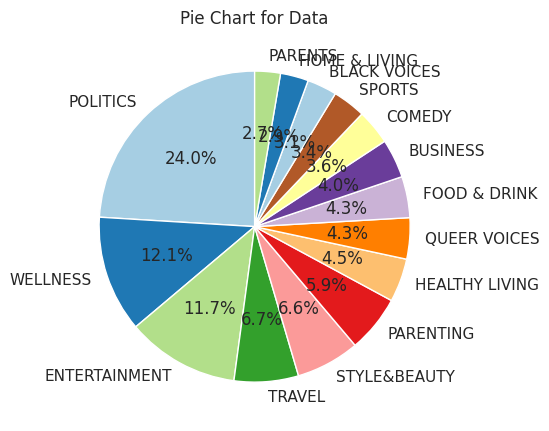

In [ ]:

import matplotlib.pyplot as plt

# Data
data = {
    'size': [35602, 17945, 17362, 9900, 9814, 8791, 6694, 6347, 6340, 5992, 5400, 5077,4583, 4320, 3955]
}

# Labels for each category
labels = ['POLITICS', 'WELLNESS', 'ENTERTAINMENT', 'TRAVEL', 'STYLE&BEAUTY', 'PARENTING', 'HEALTHY LIVING', 'QUEER VOICES', 'FOOD & DRINK', 'BUSINESS', 'COMEDY', 'SPORTS', 'BLACK VOICES', 'HOME & LIVING','PARENTS']

# Create a pie chart
plt.pie(data['size'], labels=labels, autopct='%1.1f%%', startangle=90, colors=plt.cm.Paired.colors)
plt.title('Pie Chart for Data')

# Display the pie chart
plt.show()

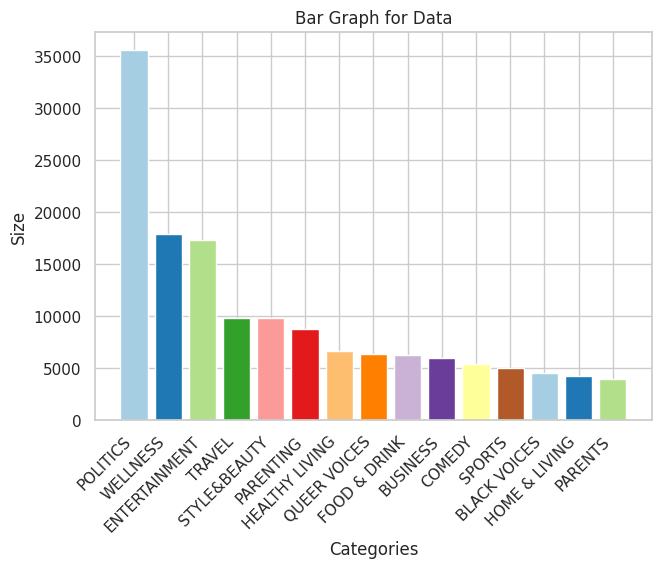

In [ ]:
import matplotlib.pyplot as plt

# Data
data = {
    'size': [35602, 17945, 17362, 9900, 9814, 8791, 6694, 6347, 6340, 5992, 5400, 5077, 4583, 4320, 3955]
}

# Labels for each category
labels = ['POLITICS', 'WELLNESS', 'ENTERTAINMENT', 'TRAVEL', 'STYLE&BEAUTY', 'PARENTING', 'HEALTHY LIVING', 'QUEER VOICES', 'FOOD & DRINK', 'BUSINESS', 'COMEDY', 'SPORTS', 'BLACK VOICES', 'HOME & LIVING','PARENTS']

# Create a bar graph
plt.bar(labels, data['size'], color=plt.cm.Paired.colors)
plt.xticks(rotation=45, ha="right")  # Rotate labels for better readability
plt.title('Bar Graph for Data')
plt.xlabel('Categories')
plt.ylabel('Size')

# Display the bar graph
plt.show()

In [ ]:
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.naive_bayes import MultinomialNB

# Load your labeled dataset (replace 'your_labeled_dataset.csv' with the actual file path)
df = pd.read_csv('/content/mydb1.project.csv')
#df = pd.read_csv('/content/mydb1.project.csv', encoding='utf-8')


# Check if columns exist in the DataFrame
if 'headline' in df.columns and 'short_description' in df.columns:
    # Combine the columns and create a new column 'combined_description' with a short description
    df['combined_description'] = df['headline'] + ': ' + df['short_description'].str[:50]  # Adjust the slice as needed

    # Replace NaN values in 'combined_description' with an empty string
    df['combined_description'].fillna('', inplace=True)

    # Replace NaN values in 'category' with a placeholder or a specific category
    df['category'].fillna('unknown', inplace=True)  # Replace 'unknown' with your desired placeholder

    # Create a TfidfVectorizer to convert text data into numerical features
    tfidf_vectorizer = TfidfVectorizer(max_features=5000)  # You can adjust max_features as needed
    X_tfidf = tfidf_vectorizer.fit_transform(df['combined_description'])

    # Train a Multinomial Naive Bayes classifier
    nb_classifier = MultinomialNB()
    nb_classifier.fit(X_tfidf, df['category'])

    # Predict categories for the entire dataset
    df['predicted_category'] = nb_classifier.predict(X_tfidf)

    # Display the DataFrame with the new combined description and predicted category columns
    print(df[['combined_description', 'category', 'predicted_category']])
else:
    print("Columns not found in the DataFrame.")


                                    combined_description       category  \
0      Over 4 Million Americans Roll Up Sleeves For O...      U.S. NEWS   
1      American Airlines Flyer Charged, Banned For Li...      U.S. NEWS   
2      23 Of The Funniest Tweets About Cats And Dogs ...         COMEDY   
3      The Funniest Tweets From Parents This Week (Se...      PARENTING   
4      Woman Who Called Cops On Black Bird-Watcher Lo...      U.S. NEWS   
...                                                  ...            ...   
76398  Ted Cruz Wins Iowa Republican Caucus: You coul...       POLITICS   
76399  Here's Why Polls Got The Republican Caucus Wro...       POLITICS   
76400  'The Bachelor' Season 20 Episode 5 Recap: The ...  ENTERTAINMENT   
76401  Bernie Sanders Exploits Hillary Clinton's Flaw...       POLITICS   
76402                                                           unknown   

      predicted_category  
0               POLITICS  
1          THE WORLDPOST  
2                 

In [ ]:
# now check the shape. note that shape is reduced which shows that we did has duplicate rows.
print(df.shape)
df.head()

(76403, 9)


,_id,link,headline,category,short_description,authors,date,combined_description,predicted_category
0,654b082afdb6c207af1ec86f,https://www.huffpost.com/entry/covid-boosters-...,Over 4 Million Americans Roll Up Sleeves For O...,U.S. NEWS,Health experts said it is too early to predict...,"Carla K. Johnson, AP",2022-09-23,Over 4 Million Americans Roll Up Sleeves For O...,POLITICS
1,654b082afdb6c207af1ec870,https://www.huffpost.com/entry/american-airlin...,"American Airlines Flyer Charged, Banned For Li...",U.S. NEWS,He was subdued by passengers and crew when he ...,Mary Papenfuss,2022-09-23,"American Airlines Flyer Charged, Banned For Li...",THE WORLDPOST
2,654b082afdb6c207af1ec871,https://www.huffpost.com/entry/funniest-tweets...,23 Of The Funniest Tweets About Cats And Dogs ...,COMEDY,"""Until you have a dog you don't understand wha...",Elyse Wanshel,2022-09-23,23 Of The Funniest Tweets About Cats And Dogs ...,COMEDY
3,654b082afdb6c207af1ec872,https://www.huffpost.com/entry/funniest-parent...,The Funniest Tweets From Parents This Week (Se...,PARENTING,"""Accidentally put grown-up toothpaste on my to...",Caroline Bologna,2022-09-23,The Funniest Tweets From Parents This Week (Se...,PARENTS
4,654b082afdb6c207af1ec873,https://www.huffpost.com/entry/amy-cooper-lose...,Woman Who Called Cops On Black Bird-Watcher Lo...,U.S. NEWS,Amy Cooper accused investment firm Franklin Te...,Nina Golgowski,2022-09-22,Woman Who Called Cops On Black Bird-Watcher Lo...,POLITICS


In [ ]:
df.drop_duplicates(subset=['category','combined_description'],keep='first',inplace=True)

In [ ]:
print(df.shape)
df.head()

(75328, 9)


,_id,link,headline,category,short_description,authors,date,combined_description,predicted_category
0,654b082afdb6c207af1ec86f,https://www.huffpost.com/entry/covid-boosters-...,Over 4 Million Americans Roll Up Sleeves For O...,U.S. NEWS,Health experts said it is too early to predict...,"Carla K. Johnson, AP",2022-09-23,Over 4 Million Americans Roll Up Sleeves For O...,POLITICS
1,654b082afdb6c207af1ec870,https://www.huffpost.com/entry/american-airlin...,"American Airlines Flyer Charged, Banned For Li...",U.S. NEWS,He was subdued by passengers and crew when he ...,Mary Papenfuss,2022-09-23,"American Airlines Flyer Charged, Banned For Li...",THE WORLDPOST
2,654b082afdb6c207af1ec871,https://www.huffpost.com/entry/funniest-tweets...,23 Of The Funniest Tweets About Cats And Dogs ...,COMEDY,"""Until you have a dog you don't understand wha...",Elyse Wanshel,2022-09-23,23 Of The Funniest Tweets About Cats And Dogs ...,COMEDY
3,654b082afdb6c207af1ec872,https://www.huffpost.com/entry/funniest-parent...,The Funniest Tweets From Parents This Week (Se...,PARENTING,"""Accidentally put grown-up toothpaste on my to...",Caroline Bologna,2022-09-23,The Funniest Tweets From Parents This Week (Se...,PARENTS
4,654b082afdb6c207af1ec873,https://www.huffpost.com/entry/amy-cooper-lose...,Woman Who Called Cops On Black Bird-Watcher Lo...,U.S. NEWS,Amy Cooper accused investment firm Franklin Te...,Nina Golgowski,2022-09-22,Woman Who Called Cops On Black Bird-Watcher Lo...,POLITICS


In [ ]:
for review in df['combined_description'][:5]:
    print(review+'\n'+'\n')

Over 4 Million Americans Roll Up Sleeves For Omicron-Targeted COVID Boosters: Health experts said it is too early to predict whe


American Airlines Flyer Charged, Banned For Life After Punching Flight Attendant On Video: He was subdued by passengers and crew when he fled


23 Of The Funniest Tweets About Cats And Dogs This Week (Sept. 17-23): "Until you have a dog you don't understand what co


The Funniest Tweets From Parents This Week (Sept. 17-23): "Accidentally put grown-up toothpaste on my toddle


Woman Who Called Cops On Black Bird-Watcher Loses Lawsuit Against Ex-Employer: Amy Cooper accused investment firm Franklin Temple




pre-processing steps :

1 ) first removing punctuation and html tags if any. note that the html tas may be present ast the data must be scraped from net.

tokenize the reviews into tokens or words .

next remove the stop words and shorter words as they cause noise and remove some stray slangs.

stem or lemmatize the words depensing on what does better.



In [ ]:
import re
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import PorterStemmer

def clean_and_preprocess_text(text):
    # Remove special characters and numbers
    text = re.sub(r'[^a-zA-Z\s]', '', text)

    # Convert to lowercase
    text = text.lower()

    # Tokenize the text
    words = word_tokenize(text)

    # Remove stop words
    stop_words = set(stopwords.words('english'))
    words = [word for word in words if word not in stop_words]

    # Perform stemming
    stemmer = PorterStemmer()
    words = [stemmer.stem(word) for word in words]

    # Join the words back into a single string
    processed_text = ' '.join(words)

    return processed_text


In [ ]:
# Function to mark sentiment based on category
def mark_sentiment(category):
    categories = ['POLITICS', 'WELLNESS', 'ENTERTAINMENT', 'TRAVEL', 'STYLE&BEAUTY', 'PARENTING', 'HEALTHY LIVING', 'QUEER VOICES', 'FOOD & DRINK', 'BUSINESS', 'COMEDY', 'SPORTS', 'BLACK VOICES', 'HOME & LIVING', 'PARENTS']

    if category in categories:
        return categories.index(category)
    else:
        return -1  # Return -1 for categories not found in the list

In [ ]:
# function to clean and pre-process the text.
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
plt.style.use('fivethirtyeight')

%matplotlib inline
%config InlineBackend.figure_format = 'retina'
import re
from bs4 import BeautifulSoup
from nltk.tokenize import WordPunctTokenizer
tok = WordPunctTokenizer()
pat1 = r'@[A-Za-z0-9_]+'
pat2 = r'https?://[^ ]+'
combined_pat = r'|'.join((pat1, pat2))
www_pat = r'www.[^ ]+'
negations_dic = {"isn't":"is not", "aren't":"are not", "wasn't":"was not", "weren't":"were not",
                "haven't":"have not","hasn't":"has not","hadn't":"had not","won't":"will not",
                "wouldn't":"would not", "don't":"do not", "doesn't":"does not","didn't":"did not",
                "can't":"can not","couldn't":"could not","shouldn't":"should not","mightn't":"might not",
                "mustn't":"must not"}
neg_pattern = re.compile(r'\b(' + '|'.join(negations_dic.keys()) + r')\b')
def clean_reviews(review):


     #1.Removing html tags
    soup = BeautifulSoup(review, 'lxml')
    souped = soup.get_text()
    try:
        bom_removed = souped.decode("utf-8-sig").replace(u"\ufffd", "?")
    except:
        bom_removed = souped
    stripped = re.sub(combined_pat, '', bom_removed)
    stripped = re.sub(www_pat, '', stripped)
    lower_case = stripped.lower()
    neg_handled = neg_pattern.sub(lambda x: negations_dic[x.group()], lower_case)

    # 2. Retaining only alphabets.
    review_text = re.sub("[^a-zA-Z]"," ",neg_handled)

    # 3. Converting to lower case and splitting
    word_tokens= review_text.lower().split()

    # 4. Remove stopwords
    le=WordNetLemmatizer()
    #stop_words= set(stopwords.words("english"))
    word_tokens= [le.lemmatize(w) for w in word_tokens if not w in stop_words]

    cleaned_review=" ".join(word_tokens)
    return cleaned_review

In [ ]:
print ("Cleaning the reviews...\n")
clean_review_texts = []
if review in df.index:
    clean_review_texts.append(clean_reviews(df['combined_description'][i]))
else:
    print("Index {} does not exist".format(review))

Cleaning the reviews...

Index Woman Who Called Cops On Black Bird-Watcher Loses Lawsuit Against Ex-Employer: Amy Cooper accused investment firm Franklin Temple does not exist


In [ ]:
df['sentiment']=df['category'].apply(mark_sentiment)

In [ ]:
df.drop(['category'],axis=1,inplace=True)

In [ ]:
df.head()

,_id,link,headline,short_description,authors,date,combined_description,predicted_category,sentiment
0,654b082afdb6c207af1ec86f,https://www.huffpost.com/entry/covid-boosters-...,Over 4 Million Americans Roll Up Sleeves For O...,Health experts said it is too early to predict...,"Carla K. Johnson, AP",2022-09-23,Over 4 Million Americans Roll Up Sleeves For O...,POLITICS,-1
1,654b082afdb6c207af1ec870,https://www.huffpost.com/entry/american-airlin...,"American Airlines Flyer Charged, Banned For Li...",He was subdued by passengers and crew when he ...,Mary Papenfuss,2022-09-23,"American Airlines Flyer Charged, Banned For Li...",THE WORLDPOST,-1
2,654b082afdb6c207af1ec871,https://www.huffpost.com/entry/funniest-tweets...,23 Of The Funniest Tweets About Cats And Dogs ...,"""Until you have a dog you don't understand wha...",Elyse Wanshel,2022-09-23,23 Of The Funniest Tweets About Cats And Dogs ...,COMEDY,10
3,654b082afdb6c207af1ec872,https://www.huffpost.com/entry/funniest-parent...,The Funniest Tweets From Parents This Week (Se...,"""Accidentally put grown-up toothpaste on my to...",Caroline Bologna,2022-09-23,The Funniest Tweets From Parents This Week (Se...,PARENTS,5
4,654b082afdb6c207af1ec873,https://www.huffpost.com/entry/amy-cooper-lose...,Woman Who Called Cops On Black Bird-Watcher Lo...,Amy Cooper accused investment firm Franklin Te...,Nina Golgowski,2022-09-22,Woman Who Called Cops On Black Bird-Watcher Lo...,POLITICS,-1


In [ ]:
df['sentiment'].value_counts()

 0     25598
-1     23343
 2      9259
 7      3005
 10     2687
 6      2572
 12     2436
 11     2098
 14     1928
 9      1252
 3       679
 13      125
 1       118
 5       114
 8       114
Name: sentiment, dtype: int64

In [ ]:
politics_df=df.loc[df.sentiment==0,:][:50000]
wellness_df=df.loc[df.sentiment==1,:][:50000]
entertaiment_df=df.loc[df.sentiment==2,:][:50000]
travel_df=df.loc[df.sentiment==3,:][:50000]
stylebeauty_df=df.loc[df.sentiment==4,:][:50000]
parenting_df=df.loc[df.sentiment==5,:][:50000]
healthy_living_df=df.loc[df.sentiment==6,:][:50000]
queer_voices_df=df.loc[df.sentiment==7,:][:50000]
food_drink_df=df.loc[df.sentiment==8,:][:50000]
business_df=df.loc[df.sentiment==9,:][:50000]
comedy_df=df.loc[df.sentiment==10,:][:50000]
sports_df=df.loc[df.sentiment==11,:][:50000]
black_voices_df=df.loc[df.sentiment==12,:][:50000]
home_living_df=df.loc[df.sentiment==13,:][:50000]
parents_df=df.loc[df.sentiment==14,:][:50000]

In [ ]:
politics_df.head()

,_id,link,headline,short_description,authors,date,combined_description,predicted_category,sentiment
21,654b082afdb6c207af1ec884,https://www.huffpost.com/entry/biden-us-forces...,Biden Says U.S. Forces Would Defend Taiwan If ...,President issues vow as tensions with China rise.,NaN,2022-09-19,Biden Says U.S. Forces Would Defend Taiwan If ...,POLITICS,0
24,654b082afdb6c207af1ec887,https://www.huffpost.com/entry/ukraine-festiva...,‘Beautiful And Sad At The Same Time’: Ukrainia...,An annual celebration took on a different feel...,Jonathan Nicholson,2022-09-19,‘Beautiful And Sad At The Same Time’: Ukrainia...,QUEER VOICES,0
30,654b082afdb6c207af1ec88d,https://www.huffpost.com/entry/europe-britain-...,Biden Says Queen's Death Left 'Giant Hole' For...,"U.S. President Joe Biden, in London for the fu...","Darlene Superville, AP",2022-09-18,Biden Says Queen's Death Left 'Giant Hole' For...,POLITICS,0
40,654b082afdb6c207af1ec897,https://www.huffpost.com/entry/afghan-adjustme...,Bill To Help Afghans Who Escaped Taliban Faces...,Republican outrage over the shoddy U.S. withdr...,Hamed Ahmadi and Arthur Delaney,2022-09-16,Bill To Help Afghans Who Escaped Taliban Faces...,POLITICS,0
44,654b082afdb6c207af1ec89b,https://www.huffpost.com/entry/capitol-riot-in...,Mark Meadows Complies With Justice Dept. Subpo...,The former White House chief of staff has turn...,"ERIC TUCKER, AP",2022-09-15,Mark Meadows Complies With Justice Dept. Subpo...,POLITICS,0


In [ ]:
wellness_df.head()

,_id,link,headline,short_description,authors,date,combined_description,predicted_category,sentiment
134,654b082afdb6c207af1ec8f5,https://www.huffpost.com/entry/signs-of-teeth-...,6 Signs You’re Grinding Your Teeth At Night (A...,"Beyond toothaches, there are other common red ...",Jillian Wilson,2022-08-30,6 Signs You’re Grinding Your Teeth At Night (A...,POLITICS,1
195,654b082afdb6c207af1ec932,https://www.huffpost.com/entry/chest-pain-hear...,How To Tell If Your Chest Pain Is A Heart Problem,Concerned your chest pain might be heart-relat...,Ashley Broadwater,2022-08-19,How To Tell If Your Chest Pain Is A Heart Prob...,HEALTHY LIVING,1
278,654b082afdb6c207af1ec985,https://www.huffpost.com/entry/fertility-treat...,Fertility Treatment Puts Many Families In Debt...,Experts share their advice for easing the fina...,Caroline Bologna,2022-08-05,Fertility Treatment Puts Many Families In Debt...,POLITICS,1
299,654b082afdb6c207af1ec99a,https://www.huffpost.com/entry/micro-transiton...,4 'Micro-Transitions' In Your Day That May Be ...,Certain points during your day can spark stres...,Alexandra Frost,2022-08-01,4 'Micro-Transitions' In Your Day That May Be ...,HEALTHY LIVING,1
322,654b082afdb6c207af1ec9b1,https://www.huffpost.com/entry/can-i-let-cat-o...,Should I Take My Cat Out In This Heat?,Certain temperatures are too dangerous for pet...,Caroline Bologna,2022-07-27,Should I Take My Cat Out In This Heat?: Certai...,POLITICS,1


In [ ]:
entertaiment_df.head()

,_id,link,headline,short_description,authors,date,combined_description,predicted_category,sentiment
20,654b082afdb6c207af1ec883,https://www.huffpost.com/entry/golden-globes-r...,Golden Globes Returning To NBC In January Afte...,"For the past 18 months, Hollywood has effectiv...",NaN,2022-09-20,Golden Globes Returning To NBC In January Afte...,ENTERTAINMENT,2
28,654b082afdb6c207af1ec88b,https://www.huffpost.com/entry/james-cameron-f...,James Cameron Says He 'Clashed' With Studio Be...,"The ""Avatar"" director said aspects of his 2009...",Ben Blanchet,2022-09-18,James Cameron Says He 'Clashed' With Studio Be...,ENTERTAINMENT,2
39,654b082afdb6c207af1ec896,https://www.huffpost.com/entry/blade-runner-20...,Amazon Greenlights 'Blade Runner 2099' Limited...,The director of the original 1982 film joins a...,Marco Margaritoff,2022-09-16,Amazon Greenlights 'Blade Runner 2099' Limited...,ENTERTAINMENT,2
43,654b082afdb6c207af1ec89a,https://www.huffpost.com/entry/the-phantom-of-...,'The Phantom Of The Opera' To Close On Broadwa...,“The Phantom of the Opera” — Broadway’s longes...,"Mark Kennedy, AP",2022-09-16,'The Phantom Of The Opera' To Close On Broadwa...,ENTERTAINMENT,2
47,654b082afdb6c207af1ec89e,https://www.huffpost.com/entry/viola-davis-wom...,Viola Davis Feared A Heart Attack During 'The ...,The Oscar winner said she worked out for five ...,Marco Margaritoff,2022-09-15,Viola Davis Feared A Heart Attack During 'The ...,ENTERTAINMENT,2


In [ ]:
df=pd.concat([politics_df,wellness_df,entertaiment_df,travel_df,stylebeauty_df,parenting_df,healthy_living_df,queer_voices_df,food_drink_df,business_df,comedy_df,sports_df,black_voices_df,home_living_df,parents_df],ignore_index=True)
df=df[['combined_description', 'sentiment', 'predicted_category']]

In [ ]:
print(df.shape)
df.head(100)

(51985, 3)


,combined_description,sentiment,predicted_category
0,Biden Says U.S. Forces Would Defend Taiwan If ...,0,POLITICS
1,‘Beautiful And Sad At The Same Time’: Ukrainia...,0,QUEER VOICES
2,Biden Says Queen's Death Left 'Giant Hole' For...,0,POLITICS
3,Bill To Help Afghans Who Escaped Taliban Faces...,0,POLITICS
4,Mark Meadows Complies With Justice Dept. Subpo...,0,POLITICS
...,...,...,...
95,Former FDA Commissioner: U.S. Has Probably ‘Fa...,0,POLITICS
96,Ohio Girl's Abortion Doctor Once Targeted In V...,0,POLITICS
97,Trump-Supporting GOP Congressman Faces Electio...,0,POLITICS
98,Senator Ted Cruz Says Supreme Court Was Wrong ...,0,POLITICS


In [ ]:
import pandas as pd
import re

# Assuming you have a function named clean_reviews to clean the text
def clean_reviews(text):
    if pd.isna(text):
        return ''  # or any other desired handling for NaN values
    # Your cleaning logic here
    cleaned_text = re.sub(r'[^a-zA-Z\s]', '', text).lower()
    return cleaned_text

# Apply the cleaning function to 'combined_description'
df['clean_review'] = df['combined_description'].apply(clean_reviews)

# Create a new DataFrame with cleaned text and target values
clean_df = pd.DataFrame({'clean_review': df['clean_review'], 'target': df['sentiment']})

# Drop NaN values in the 'clean_review' column
clean_df = clean_df.dropna(subset=['clean_review'])

# Save the cleaned DataFrame to a CSV file
clean_df.to_csv('clean_review1.csv', encoding='utf-8', index=False)

# Read the cleaned DataFrame from the CSV file
csv = 'clean_review1.csv'
my_df = pd.read_csv(csv)

# Display the cleaned DataFrame
print(my_df)


                                            clean_review  target
0      biden says us forces would defend taiwan if ch...       0
1      beautiful and sad at the same time ukrainian c...       0
2      biden says queens death left giant hole for ro...       0
3      bill to help afghans who escaped taliban faces...       0
4      mark meadows complies with justice dept subpoe...       0
...                                                  ...     ...
51980  video shows what happens when moms become thei...      14
51981  amazon and american girl are teaming up for li...      14
51982  less than half of toddlers in the us have full...      14
51983  after  long years watch this mother and daught...      14
51984   social media tips from a toddler always like ...      14

[51985 rows x 2 columns]


In [ ]:
# shuffling rows
df = df.sample(frac=1).reset_index(drop=True)
print(df.shape)  # perfectly fine.
df.head()

(51985, 4)


,combined_description,sentiment,predicted_category,clean_review
0,This Thread Might Explain Why Certain TV Show ...,2,ENTERTAINMENT,this thread might explain why certain tv show ...
1,States Step Up To Help Traumatized Veterans: V...,0,POLITICS,states step up to help traumatized veterans ve...
2,This Is Your Brain On Trump: Do you ever find ...,0,HEALTHY LIVING,this is your brain on trump do you ever find y...
3,Nancy Pelosi Knocks Trump: 'What Does Putin Ha...,0,POLITICS,nancy pelosi knocks trump what does putin have...
4,Teen Dies After Helicopter Crashes Near Arizon...,0,CRIME,teen dies after helicopter crashes near arizon...


In [ ]:
df.dropna(inplace=True)
df.reset_index(drop=True,inplace=True)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51985 entries, 0 to 51984
Data columns (total 4 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   combined_description  51985 non-null  object
 1   sentiment             51985 non-null  int64 
 2   predicted_category    51985 non-null  object
 3   clean_review          51985 non-null  object
dtypes: int64(1), object(3)
memory usage: 1.6+ MB


In [ ]:
!pip install wordcloud

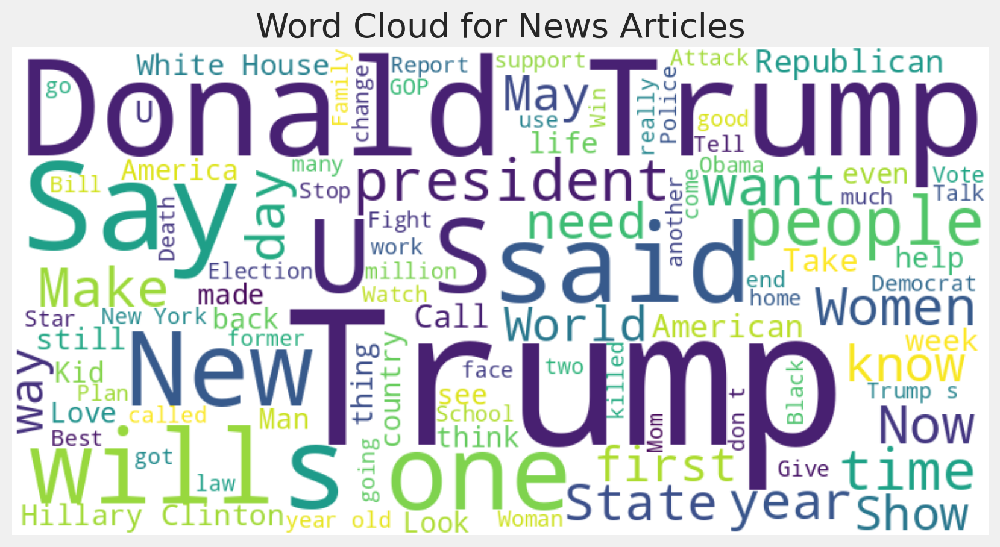

In [ ]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Load your dataset
# Assuming you have a CSV file with columns 'id', 'link', 'combined_text', 'authors', 'date', and 'category'
df = pd.read_csv('mydb1.project.csv')

# Combine headline and short description text
df['combined_text'] = df['headline'] + ' ' + df['short_description']

# Generate a Word Cloud
text_combined = ' '.join(df['combined_text'].dropna())  # Combine all text into a single string
wordcloud = WordCloud(width=800, height=400, random_state=42, max_words=100, background_color='white').generate(text_combined)

# Display the Word Cloud
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud for News Articles')
plt.show()


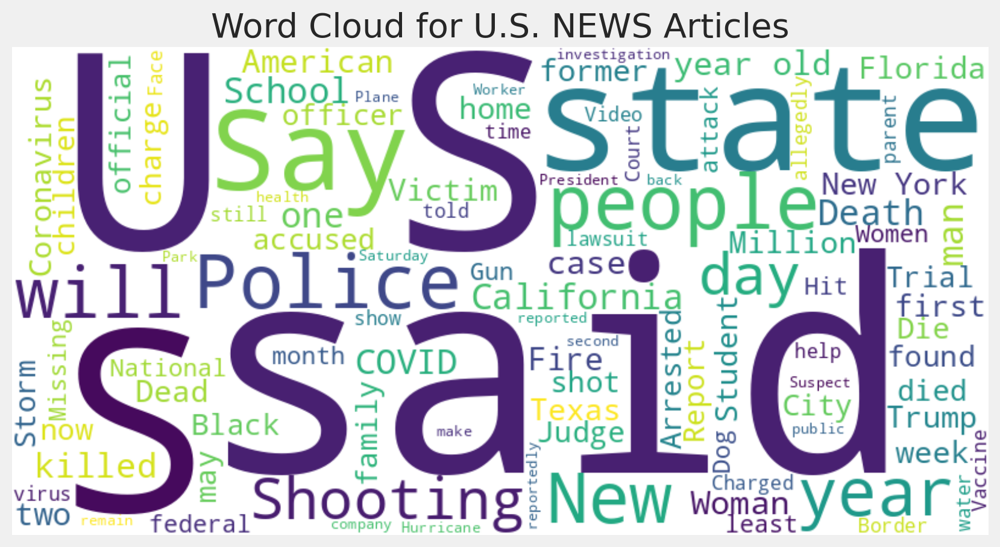

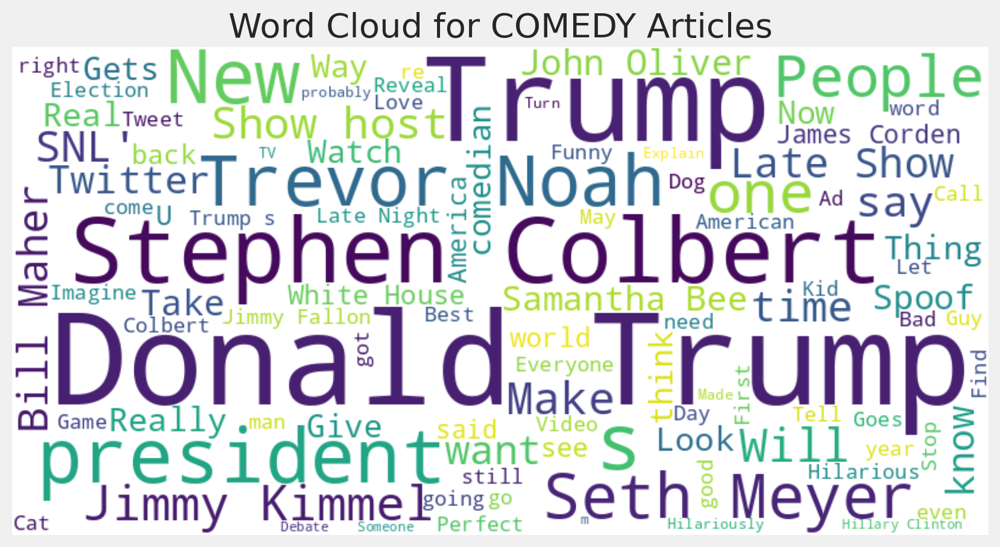

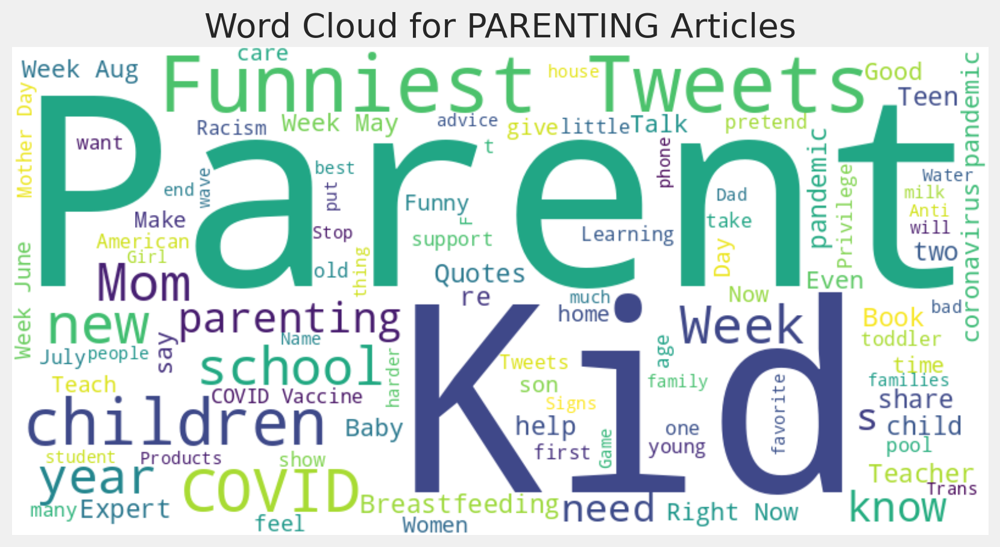

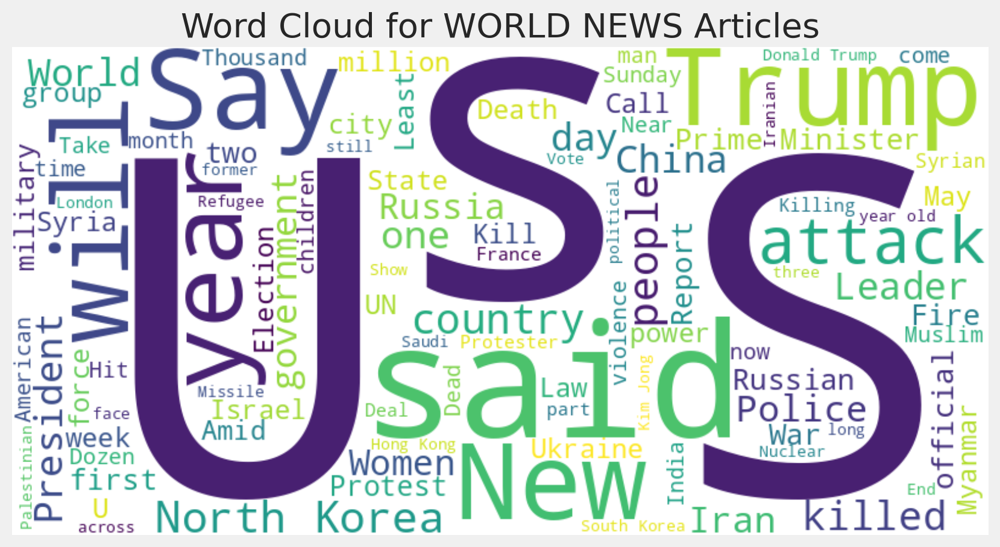

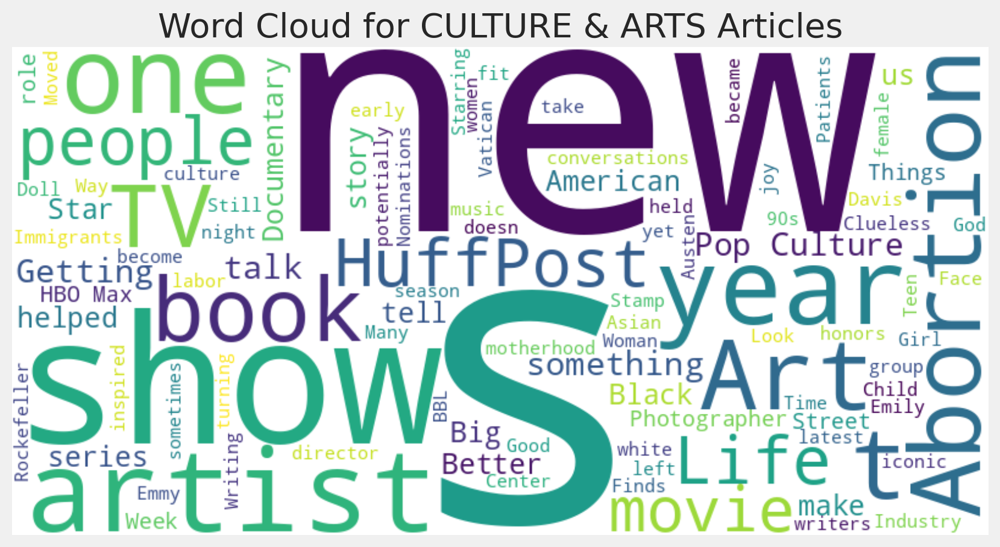

...

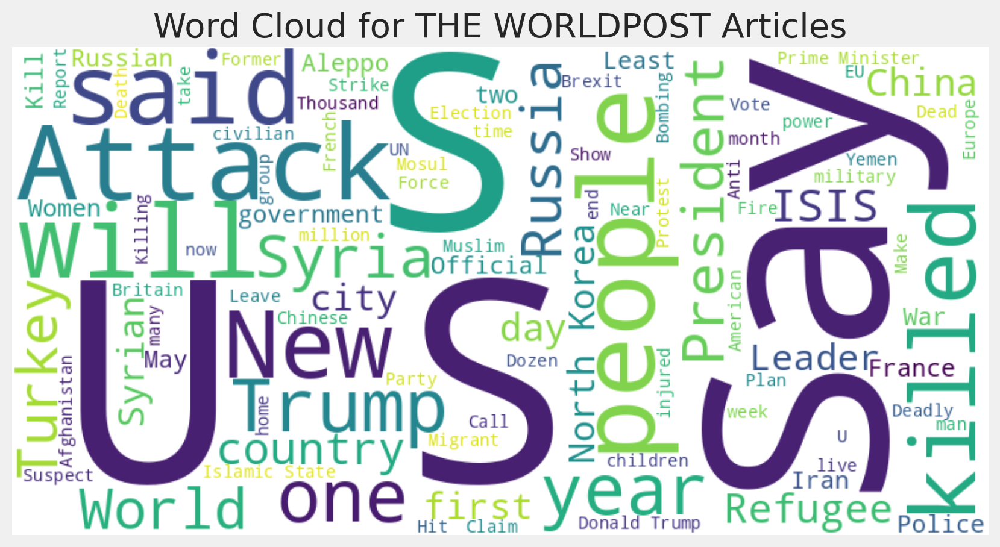

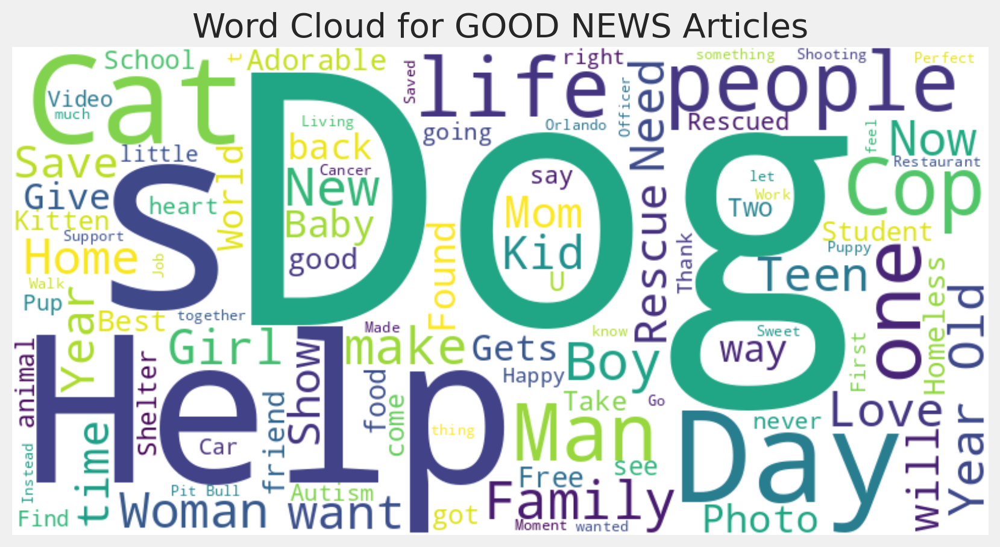

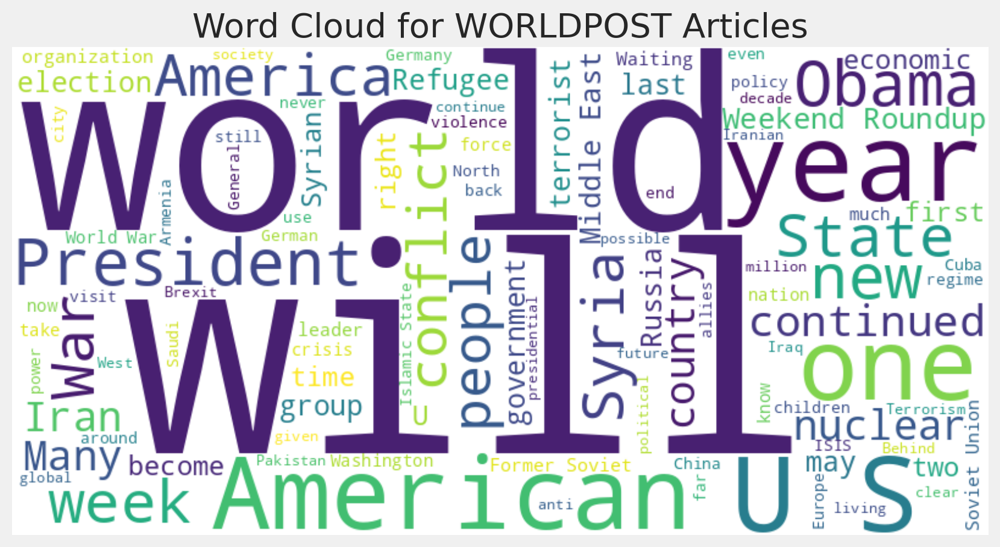

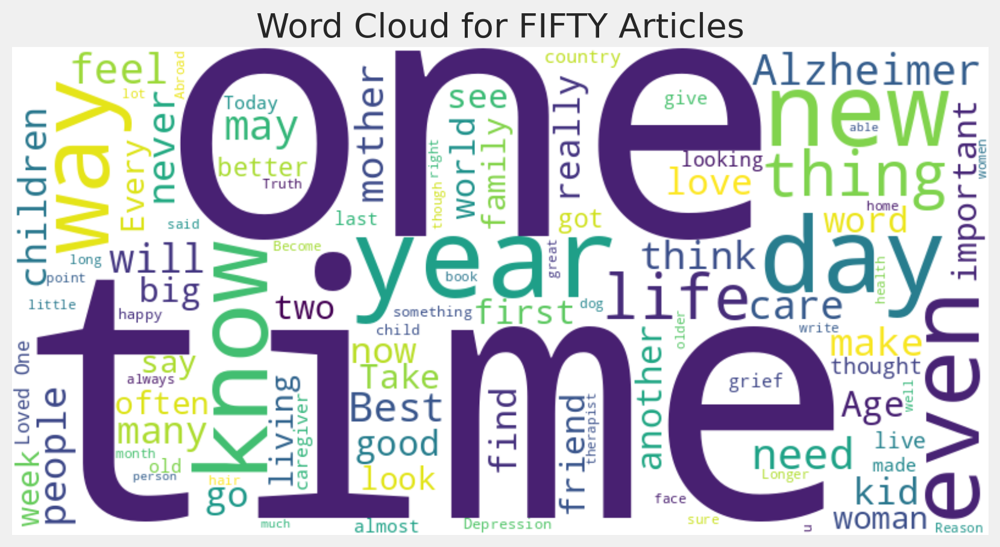

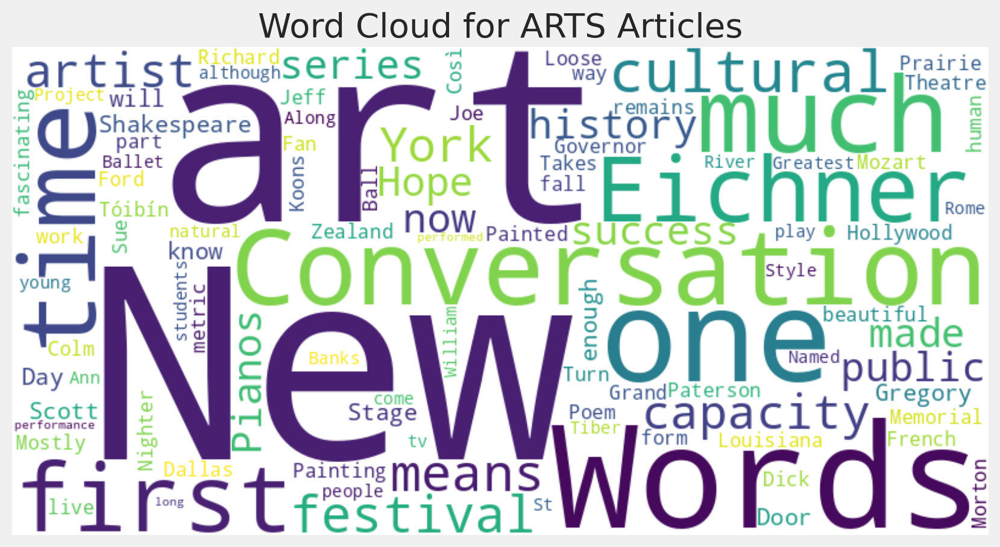

No data available for the category: nan


In [ ]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Load your dataset
# Assuming you have a CSV file with columns 'id', 'link', 'combined_text', 'authors', 'date', and 'category'
df = pd.read_csv('mydb1.project.csv')

# Combine headline and short description text
df['combined_text'] = df['headline'] + ' ' + df['short_description']

# Generate Word Clouds for Each Category
categories = df['category'].unique()

for category in categories:
    # Filter data for the specific category
    category_data = df[df['category'] == category]
    category_data = category_data.dropna(subset=['combined_text'])  # Drop rows with null values in 'combined_text'

    # Check if there is any text for the specific category
    if not category_data['combined_text'].empty:
        # Combine text for the specific category
        text_combined = ' '.join(category_data['combined_text'])

        # Generate Word Cloud
        wordcloud = WordCloud(width=800, height=400, random_state=42, max_words=100, background_color='white').generate(text_combined)

        # Display the Word Cloud
        plt.figure(figsize=(10, 5))
        plt.imshow(wordcloud, interpolation='bilinear')
        plt.axis('off')
        plt.title(f'Word Cloud for {category} Articles')
        plt.show()

        # Optionally, save the Word Cloud image
        # plt.savefig(f'wordcloud_{category}.png', bbox_inches='tight')
    else:
        print(f"No data available for the category: {category}")

In [ ]:
!pip install pyspark


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 316.9/316.9 MB 3.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pyspark: filename=pyspark-3.5.0-py2.py3-none-any.whl size=317425345 sha256=d92b97e65e49f1807ea8a7a3b5b92d96cc7bac018e3ecdc4c7f2036f33108a83
  Stored in directory: /root/.cache/pip/wheels/41/4e/10/c2cf2467f71c678cfc8a6b9ac9241e5e44a01940da8fbb17fc
Successfully built pyspark


In [ ]:
from pyspark.sql import SparkSession

spark = SparkSession.builder \
        .appName("myApp") \
        .config("spark.driver.memory", "10g") \
        .getOrCreate()

sc = spark.sparkContext
df = spark.read.format('com.databricks.spark.csv').options(header='true', inferschema='true').load('clean_review1.csv')

In [ ]:
type(df)

pyspark.sql.dataframe.DataFrame

In [ ]:
df.show(5)

+--------------------+------+
|        clean_review|target|
+--------------------+------+
|biden says us for...|     0|
|beautiful and sad...|     0|
|biden says queens...|     0|
|bill to help afgh...|     0|
|mark meadows comp...|     0|
+--------------------+------+
only showing top 5 rows



In [ ]:
df = df.dropna()

In [ ]:
df.count()

51975

In [ ]:
#(train_set, test_set) = df.randomSplit([0.80, 0.2

                                        #], seed = 2000)

In [ ]:
from pyspark.ml.feature import HashingTF, IDF, Tokenizer, CountVectorizer
from pyspark.ml.feature import StringIndexer
from pyspark.ml import Pipeline
from pyspark.ml.classification import LogisticRegression
from pyspark.ml.evaluation import BinaryClassificationEvaluator

In [ ]:
'''
from pyspark.ml.feature import HashingTF, IDF, Tokenizer
from pyspark.ml.feature import StringIndexer
from pyspark.ml import Pipeline
from pyspark.sql.functions import col

# Assuming your DataFrame columns are "clean_review" and "target"
#tokenizer = Tokenizer(inputCol="clean_review", outputCol="words")
#hashingTF = HashingTF(inputCol="words", outputCol="rawFeatures", numFeatures=10000)
#idf = IDF(inputCol="rawFeatures", outputCol="features")
#label_stringIdx = StringIndexer(inputCol="target", outputCol="label")

#pipeline = Pipeline(stages=[tokenizer, hashingTF, idf, label_stringIdx])
#pipelineFit = pipeline.fit(train_set)
#train_df = pipelineFit.transform(train_set)
#test_df = pipelineFit.transform(test_set)
'''

'\nfrom pyspark.ml.feature import HashingTF, IDF, Tokenizer\nfrom pyspark.ml.feature import StringIndexer\nfrom pyspark.ml import Pipeline\nfrom pyspark.sql.functions import col\n\n# Assuming your DataFrame columns are "clean_review" and "target"\n#tokenizer = Tokenizer(inputCol="clean_review", outputCol="words")\n#hashingTF = HashingTF(inputCol="words", outputCol="rawFeatures", numFeatures=10000)\n#idf = IDF(inputCol="rawFeatures", outputCol="features")\n#label_stringIdx = StringIndexer(inputCol="target", outputCol="label")\n\n#pipeline = Pipeline(stages=[tokenizer, hashingTF, idf, label_stringIdx])\n#pipelineFit = pipeline.fit(train_set)\n#train_df = pipelineFit.transform(train_set)\n#test_df = pipelineFit.transform(test_set)\n'

In [ ]:
#from pyspark.sql.functions import col

# Assuming 'clean_review' is the column you are tokenizing
#train_set.filter(col("clean_review").isNull()).show()


In [ ]:
from pyspark.sql import SparkSession
from pyspark.ml.feature import Tokenizer, StopWordsRemover, HashingTF, IDF, VectorAssembler, StringIndexer
from pyspark.ml.classification import LogisticRegression
from pyspark.ml.evaluation import MulticlassClassificationEvaluator

# Create a Spark session
spark = SparkSession.builder.appName("LogisticRegressionMulticlass").getOrCreate()

# Load the dataset
data = spark.read.csv("/content/clean_review1.csv", header=True, inferSchema=True)

# Filter out rows with null values in the 'clean_review' column
data = data.filter(data["clean_review"].isNotNull())

# Tokenize the text column
tokenizer = Tokenizer(inputCol="clean_review", outputCol="tokens")
data = tokenizer.transform(data)

# Remove stop words
remover = StopWordsRemover(inputCol="tokens", outputCol="filtered_tokens")
data = remover.transform(data)

# Apply TF-IDF
hashingTF = HashingTF(inputCol="filtered_tokens", outputCol="rawFeatures", numFeatures=10000)
featurizedData = hashingTF.transform(data)

idf = IDF(inputCol="rawFeatures", outputCol="features")
idfModel = idf.fit(featurizedData)
data = idfModel.transform(featurizedData)

# Define the target column
target_col = "target"

# Use StringIndexer to convert the target column to numerical labels
indexer = StringIndexer(inputCol=target_col, outputCol="label")
data = indexer.fit(data).transform(data)

# Select necessary columns
data = data.select("features", "label")

# Split the data into training and testing sets
train_data, test_data = data.randomSplit([0.8, 0.2], seed=123)

# Create and train a Logistic Regression classifier for multiclass classification
lr = LogisticRegression(labelCol="label", featuresCol="features", maxIter=10, regParam=0.3, elasticNetParam=0.8)
model = lr.fit(train_data)

# Make predictions on the test data
predictions = model.transform(test_data)

# Evaluate the model using a MulticlassClassificationEvaluator
evaluator = MulticlassClassificationEvaluator(
    labelCol="label", predictionCol="prediction", metricName="accuracy"
)
accuracy = evaluator.evaluate(predictions)

# Print the accuracy of the model
print(f"Accuracy: {accuracy * 100}")

# Stop the Spark session
spark.stop()

Accuracy: 26.390983411381857


In [ ]:
from pyspark.sql import SparkSession
from pyspark.ml.feature import Tokenizer, StopWordsRemover, HashingTF, IDF, StringIndexer
from pyspark.ml.classification import RandomForestClassifier
from pyspark.ml.evaluation import MulticlassClassificationEvaluator

# Create a Spark session
spark = SparkSession.builder.appName("RandomForestMulticlass").getOrCreate()

# Load the dataset
data = spark.read.csv("/content/clean_review1.csv", header=True, inferSchema=True)

# Filter out rows with null values in the 'clean_review' column
data = data.filter(data["clean_review"].isNotNull())

# Tokenize the text column
tokenizer = Tokenizer(inputCol="clean_review", outputCol="tokens")
data = tokenizer.transform(data)

# Remove stop words
remover = StopWordsRemover(inputCol="tokens", outputCol="filtered_tokens")
data = remover.transform(data)

# Apply TF-IDF
hashingTF = HashingTF(inputCol="filtered_tokens", outputCol="rawFeatures", numFeatures=10000)
featurizedData = hashingTF.transform(data)

idf = IDF(inputCol="rawFeatures", outputCol="features")
idfModel = idf.fit(featurizedData)
data = idfModel.transform(featurizedData)

# Define the target column
target_col = "target"

# Use StringIndexer to convert the target column to numerical labels
indexer = StringIndexer(inputCol=target_col, outputCol="label")
data = indexer.fit(data).transform(data)

# Select necessary columns
data = data.select("features", "label")

# Split the data into training and testing sets
train_data, test_data = data.randomSplit([0.8, 0.2], seed=123)

# Create and train a Random Forest classifier for multiclass classification
rf = RandomForestClassifier(labelCol="label", featuresCol="features", numTrees=100, maxDepth=10)
model = rf.fit(train_data)

# Make predictions on the test data
predictions = model.transform(test_data)

# Evaluate the model using a MulticlassClassificationEvaluator
evaluator = MulticlassClassificationEvaluator(
    labelCol="label", predictionCol="prediction", metricName="accuracy"
)
accuracy = evaluator.evaluate(predictions)

# Print the accuracy of the model
print(f"Accuracy: {accuracy * 100}")

# Stop the Spark session
spark.stop()


Accuracy: 27.148980077783953


In [ ]:
from pyspark.sql import SparkSession
from pyspark.ml.feature import VectorAssembler, StringIndexer, Tokenizer, StopWordsRemover, HashingTF, IDF
from pyspark.ml.classification import LinearSVC
from pyspark.ml.evaluation import MulticlassClassificationEvaluator

# Create a Spark session
spark = SparkSession.builder.appName("SVMExampleNews").getOrCreate()

# Load the dataset
data = spark.read.csv("/content/clean_review1.csv", header=True, inferSchema=True)

# Filter out rows with null values in the 'clean_review' column
data = data.filter(data["clean_review"].isNotNull())
# Tokenize the text column
tokenizer = Tokenizer(inputCol="clean_review", outputCol="tokens")
data = tokenizer.transform(data)
# Remove stop words
remover = StopWordsRemover(inputCol="tokens", outputCol="filtered_tokens")
data = remover.transform(data)
# Apply TF-IDF
hashingTF = HashingTF(inputCol="filtered_tokens", outputCol="rawFeatures", numFeatures=10000)
featurizedData = hashingTF.transform(data)
idf = IDF(inputCol="rawFeatures", outputCol="features")
idfModel = idf.fit(featurizedData)
data = idfModel.transform(featurizedData)
# Define the target column
target_col = "target"
# Use StringIndexer to convert the target column to numerical labels
indexer = StringIndexer(inputCol=target_col, outputCol="label")
data = indexer.fit(data).transform(data)
# Modify the label to binary values (0 and 1) for LinearSVC
data = data.withColumn("label", (data["label"] == 0).cast("int"))
# Select necessary columns
data = data.select("features", "label")
# Split the data into training and testing sets
train_data, test_data = data.randomSplit([0.7, 0.3], seed=123)
# Create and train an SVM classifier
svm = LinearSVC(featuresCol="features", labelCol="label")
model = svm.fit(train_data)
# Make predictions on the test data
predictions = model.transform(test_data)
# Evaluate the model using a MulticlassClassificationEvaluator
evaluator = MulticlassClassificationEvaluator(
    labelCol="label", predictionCol="prediction", metricName="accuracy"
)
accuracy = evaluator.evaluate(predictions)
# Print the accuracy of the model
print(f"Accuracy: {accuracy * 100}")
# Stop the Spark session
spark.stop()

Accuracy: 89.3662473296938


In [ ]:
from pyspark.sql import SparkSession
from pyspark.ml.feature import Tokenizer, StopWordsRemover, HashingTF, IDF, StringIndexer
from pyspark.ml.classification import MultilayerPerceptronClassifier
from pyspark.ml.evaluation import MulticlassClassificationEvaluator
from pyspark.ml.tuning import ParamGridBuilder, CrossValidator

# Create a Spark session
spark = SparkSession.builder.appName("MLPExampleNews").getOrCreate()

# Load the dataset
data = spark.read.csv("/content/clean_review1.csv", header=True, inferSchema=True)

# Filter out rows with null values in the 'clean_review' column
data = data.filter(data["clean_review"].isNotNull())

# Tokenize the text column
tokenizer = Tokenizer(inputCol="clean_review", outputCol="tokens")
data = tokenizer.transform(data)

# Remove stop words
remover = StopWordsRemover(inputCol="tokens", outputCol="filtered_tokens")
data = remover.transform(data)

# Apply TF-IDF
hashingTF = HashingTF(inputCol="filtered_tokens", outputCol="rawFeatures", numFeatures=10000)
featurizedData = hashingTF.transform(data)

idf = IDF(inputCol="rawFeatures", outputCol="features")
idfModel = idf.fit(featurizedData)
data = idfModel.transform(featurizedData)

# Define the target column
target_col = "target"

# Use StringIndexer to convert the target column to numerical labels
indexer = StringIndexer(inputCol=target_col, outputCol="label")
data = indexer.fit(data).transform(data)

# Modify the label to binary values (0 and 1) for MLP
data = data.withColumn("label", (data["label"] == 0).cast("int"))

# Select necessary columns
data = data.select("features", "label")

# Split the data into training and testing sets
train_data, test_data = data.randomSplit([0.7, 0.3], seed=123)

# Define the layers for the Multilayer Perceptron Classifier
layers = [10000, 64, 32, 2]  # Input layer of size 10000, two hidden layers, output of size 2

# Create a Multilayer Perceptron classifier
mlp_classifier = MultilayerPerceptronClassifier(seed=123, featuresCol="features", labelCol="label")

# Create a ParamGrid for hyperparameter tuning
param_grid = ParamGridBuilder() \
    .addGrid(mlp_classifier.layers, [[10000, 64, 32, 2], [10000, 128, 64, 32, 2]]) \
    .addGrid(mlp_classifier.blockSize, [128, 256]) \
    .build()

# Define an evaluator
evaluator = MulticlassClassificationEvaluator(
    labelCol="label", predictionCol="prediction", metricName="accuracy"
)

# Define the CrossValidator with parameters
cross_val = CrossValidator(
    estimator=mlp_classifier,
    estimatorParamMaps=param_grid,
    evaluator=evaluator,
    numFolds=3
)

# Fit the CrossValidator
cv_model = cross_val.fit(train_data)

# Make predictions on the test data
predictions = cv_model.transform(test_data)

# Evaluate the model using the evaluator
accuracy = evaluator.evaluate(predictions)

# Print the accuracy of the model
print(f"Accuracy: {accuracy * 100}")

# Stop the Spark session
spark.stop()